In [1]:
from fullwaveqc import tools, geom, siganalysis, inversion, visual
import numpy as np
import matplotlib.pyplot as plt
import copy
import warnings

warnings.filterwarnings("ignore")
%reload_ext autoreload
plt.rcParams.update({'font.size': 18})

In [2]:
path    = "/geophysics2/dpelacani/PROJECTS/PARBASE25_18/"
shot_no = 200                    # shot number for amplitude plotting
x_list  = [6000, 9000]           # positions for vp-well plotting

# The true model

In [3]:
TRUE_BASE = tools.load("/geophysics2/dpelacani/true_models/Base/TRUE_enl_Vp_bl_y6250.sgy", model=True, verbose=1)
TRUE_MON = tools.load("/geophysics2/dpelacani/true_models/Monitor/TRUE_enl_Vp_mon_y6250.sgy", model=True, verbose=1)

# These SEG-Y model files are formatted differently from the outputs of Fullwave3D and, currently, FullwaveQC
# is not able to adapt to these differences. The spacing dx of the models were not properly read, so here we
# set them manually.
TRUE_BASE.dx=2.
TRUE_MON.dx = 2.


2019-08-22 13:40:50.513100 	 Opening file /geophysics2/dpelacani/true_models/Base/TRUE_enl_Vp_bl_y6250.sgy...
2019-08-22 13:40:50.523858 	 Reading model...
2019-08-22 13:40:50.958913 	 Successfully loaded model of size 2500 x 8245!
2019-08-22 13:40:50.979176 	 Opening file /geophysics2/dpelacani/true_models/Monitor/TRUE_enl_Vp_mon_y6250.sgy...
2019-08-22 13:40:50.982421 	 Reading model...
2019-08-22 13:40:51.312585 	 Successfully loaded model of size 2500 x 8245!

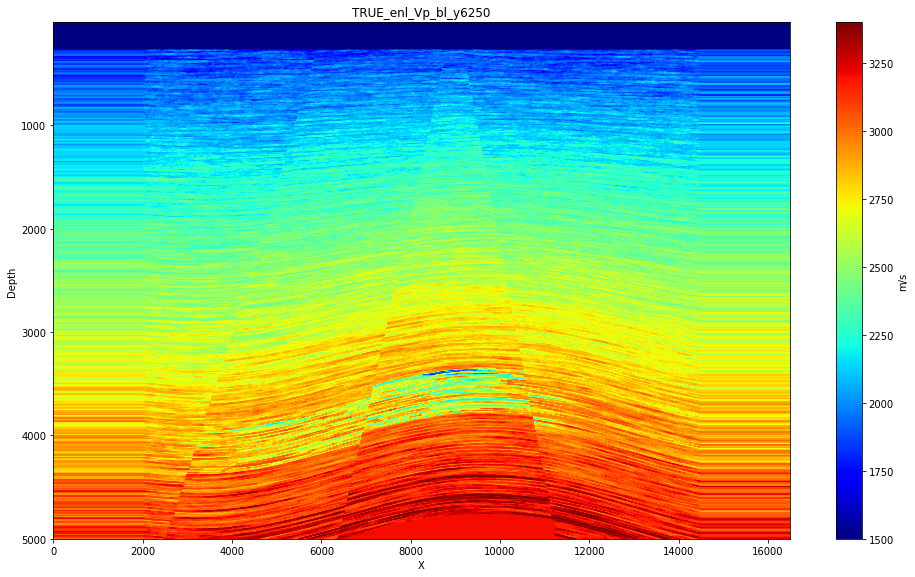

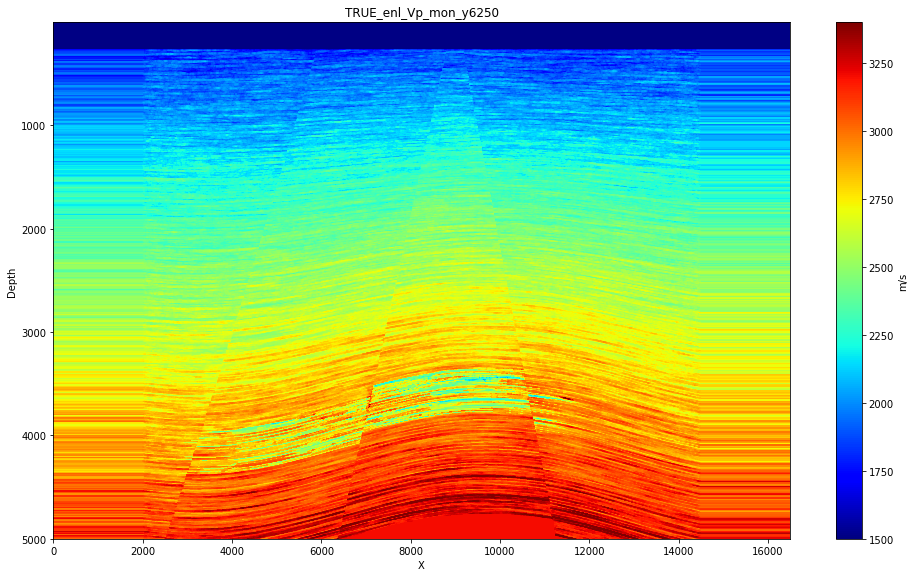

In [4]:
# Visualise true model
visual.vpmodel(TRUE_BASE, vmin=1500, vmax=3400)
visual.vpmodel(TRUE_MON, vmin=1500, vmax=3400)

In [5]:
print(TRUE_BASE.attr())

{'name': 'TRUE_enl_Vp_bl_y6250', '_type': 'model', '_filepath': '/geophysics2/dpelacani/true_models/Base/TRUE_enl_Vp_bl_y6250.sgy', 'dx': 2.0, 'nx': 8245, 'nz': 2500, 'minvp': 1473.3582, 'maxvp': 3656.3013, 'data': array([[3023.0723, 3023.0723, 3023.0723, ..., 3141.815 , 3141.815 ,
        3141.815 ],
       [3022.6118, 3022.6118, 3022.6118, ..., 3167.3213, 3167.3213,
        3167.3213],
       [3023.3853, 3023.3853, 3023.3853, ..., 3195.5962, 3195.5962,
        3195.5962],
       ...,
       [1500.    , 1500.    , 1500.    , ..., 1500.    , 1500.    ,
        1500.    ],
       [1500.    , 1500.    , 1500.    , ..., 1500.    , 1500.    ,
        1500.    ],
       [1500.    , 1500.    , 1500.    , ..., 1500.    , 1500.    ,
        1500.    ]], dtype=float32)}


# The starting model


2019-08-22 13:43:55.398158 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-StartVp.sgy...
2019-08-22 13:43:55.402549 	 Reading model...
2019-08-22 13:43:55.409928 	 Successfully loaded model of size 201 x 661!{'name': 'PARBASE25_18-StartVp', '_type': 'model', '_filepath': '/geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-StartVp.sgy', 'dx': 0, 'nx': 661, 'nz': 201, 'minvp': 1500.0, 'maxvp': 3187.6445, 'data': array([[3183.351 , 3183.351 , 3183.351 , ..., 3183.9578, 3183.9578,
        3183.9578],
       [3182.1843, 3182.1843, 3182.1843, ..., 3182.8342, 3182.8342,
        3182.8342],
       [3179.9204, 3179.9204, 3179.9204, ..., 3180.6526, 3180.6526,
        3180.6526],
       ...,
       [1500.    , 1500.    , 1500.    , ..., 1500.    , 1500.    ,
        1500.    ],
       [1500.    , 1500.    , 1500.    , ..., 1500.    , 1500.    ,
        1500.    ],
       [1500.    , 1500.    , 1500.    , ..., 1500.    , 1500.    ,
        1500.    ]], dtype=float

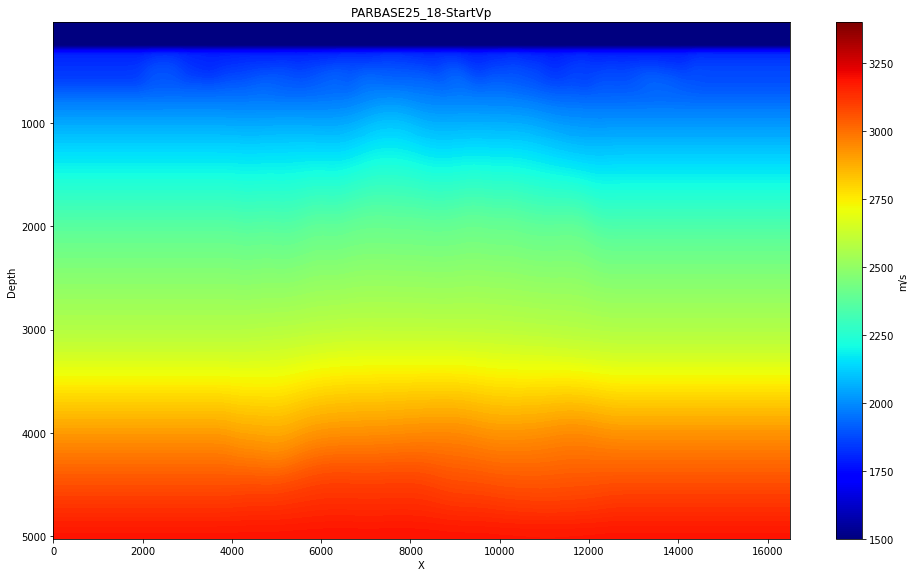

In [6]:
start_model_path = path + "PARBASE25_18-StartVp.sgy"
np.set_printoptions(threshold=1000)
START_MODEL = tools.load(start_model_path, model=True)
print(START_MODEL.attr())
START_MODEL.dx = 25.

visual.vpmodel(START_MODEL, vmin=1500, vmax=3400, cap=0.0, units="m/s", save=False)

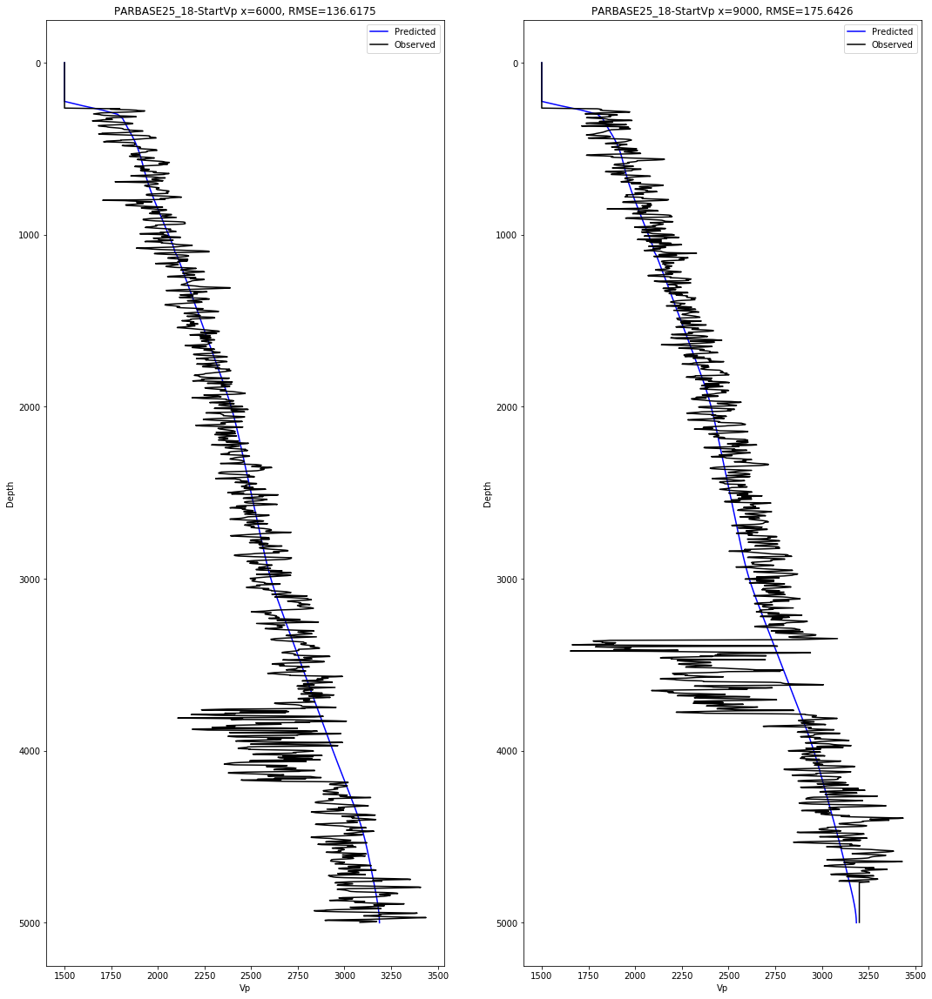

In [7]:
# Plot Vp logs of starting and true models
wells_start = visual.vpwell(START_MODEL, pos_x=x_list, TrueModel=TRUE_BASE, plot=True)

# Boundary Calculation and QC on SegyPrep Alignment

In [8]:
# Calculating number of absorbing boundarie cells and number of cells required 
# to distance the source from the absorbing boundaries
n_abs, n_dist = geom.boundarycalc(d=190, dx=25., fmin=3., vmax=3700)
print("Number of absorbing boundary cells   : ", n_abs)
print("Number of cells from source (Fresnel): ", n_dist)

Number of absorbing boundary cells   :  99
Number of cells from source (Fresnel):  10


2019-08-22 13:43:58.273132 	                          Plotting ...     

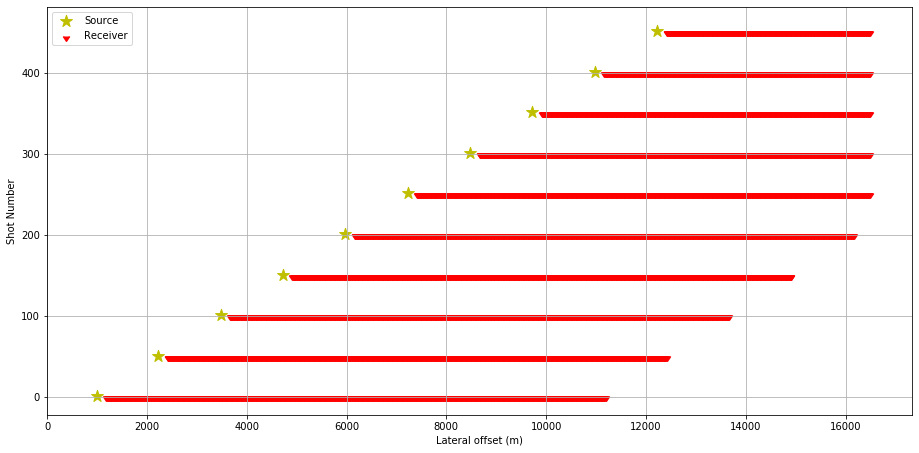

In [9]:
# Visualising (some) sources and receivers positions as understood from segyprep
rcvgeopath = path + "PARBASE25_18-Receivers.geo"
srcgeopath = path + "PARBASE25_18-Sources.geo"
src_list=[i for i in range(0, 500, 50)]
_ = geom.surveygeom(rcvgeopath, srcgeopath, src_list, plot=True, verbose=1)[1]

# Observed Data (with +2ms delay)
This is the dataset pre processed by SegyPrep and should be located in the same folder as the tomography project as <project_name>-Observed.sgy

In [10]:
OBS_BASE_DATA = tools.load(path+"PARBASE25_18-Observed.sgy", model=False, verbose=1)


2019-08-22 13:43:58.821674 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-Observed.sgy...
2019-08-22 13:43:58.838050 	 Loading data...
2019-08-22 13:44:49.349118 	 521 shots found. Loading headers...
2019-08-22 13:46:04.045738 	 322149 total traces read
2019-08-22 13:46:04.046016 	 Data loaded successfully

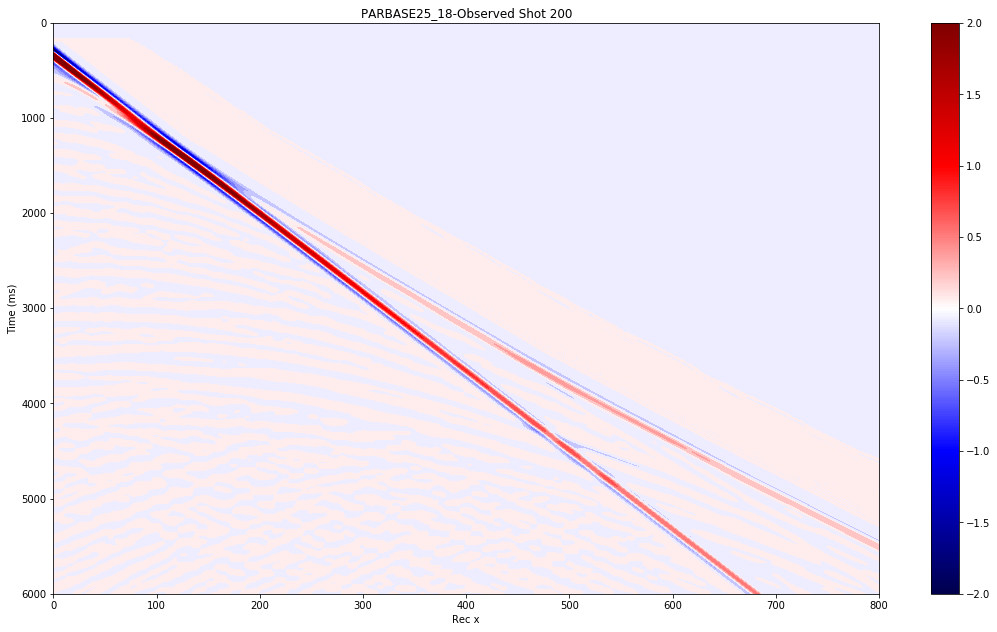

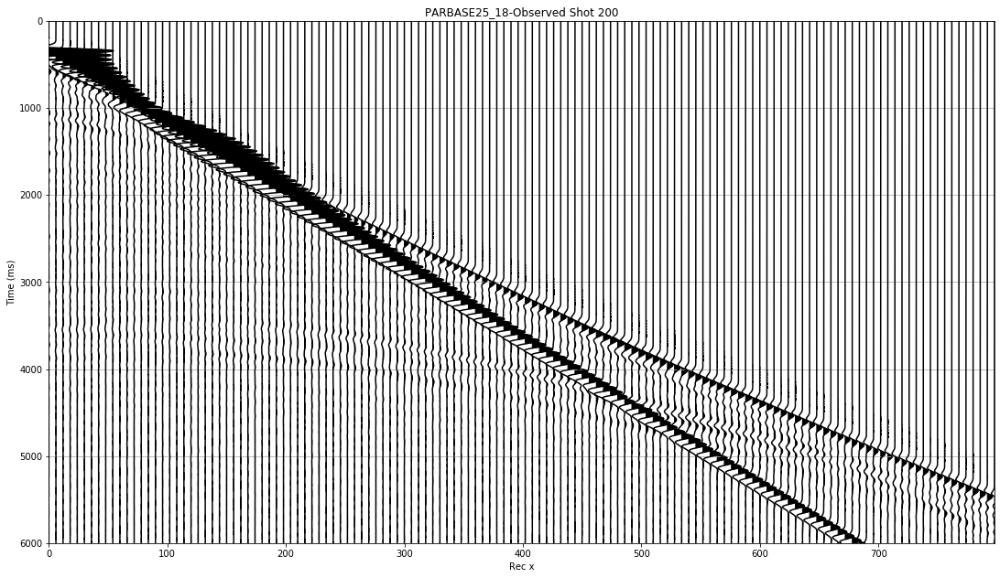

In [11]:
visual.amplitude(OBS_BASE_DATA, shot=shot_no, vmin=-2, vmax=2)
visual.wiggle(OBS_BASE_DATA, shot=shot_no, scale=14.5, skip_trace=5)

2019-08-22 13:46:09.581418 	 Sampling Frequency = 500.0000 Hz

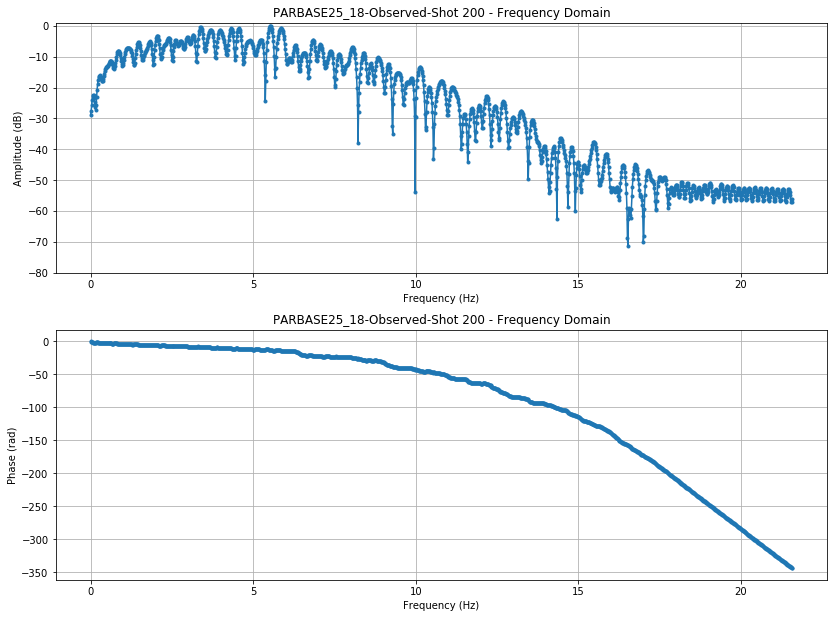

In [12]:
# Looking at the frequency content of the observed data
obs_spec = siganalysis.dataspec(OBS_BASE_DATA, shot=shot_no, ms=True, fmax=18, plot=True, fft_smooth=10)

# The wavelet
The wavelet should be looked at after the SegyPrep preprocessing is finished. This wavelet is in the project folder with name <project_name>-Signature.sgy


2019-08-22 13:46:10.724541 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-Signature.sgy...
2019-08-22 13:46:10.745096 	 Loading data...
2019-08-22 13:46:10.833495 	 1 shots found. Loading headers...
2019-08-22 13:46:10.835199 	 521 total traces read
2019-08-22 13:46:10.835333 	 Data loaded successfully

 [2000] [3.001]

2019-08-22 13:46:10.836862 	 Sampling Frequency = 500.0000 Hz

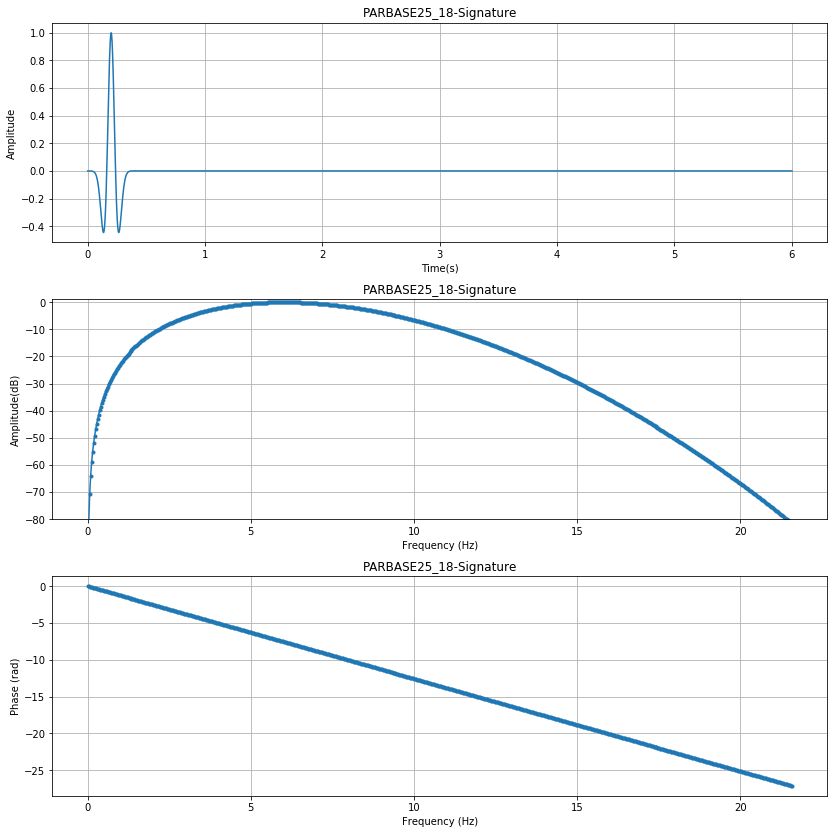

In [13]:
wavelet_path = path + "PARBASE25_18-Signature.sgy"
WAVELET = tools.load(wavelet_path, model=False)
print("\n\n", WAVELET.attr("samples"), WAVELET.attr("dt"))

# Manually setting parameters that failed to be read properly by tools.load
WAVELET.samples = [3001]
WAVELET.dt = [2.]

wavelet = siganalysis.wavespec(WAVELET, ms=True, fmax=18, plot=True, fft_smooth=5)

# Forward Run on the Starting Model (START25FORALL_18)
Synthetic run over the starting model with the same parameters as the inversion of PARBASE25_18

In [14]:
START_DATA = tools.load("/geophysics2/dpelacani/PROJECTS/START25FORALL_18/START25FORALL_18-Synthetic.sgy", model=False, verbose=1)


2019-08-22 13:46:11.957489 	 Opening file /geophysics2/dpelacani/PROJECTS/START25FORALL_18/START25FORALL_18-Synthetic.sgy...
2019-08-22 13:46:11.960353 	 Loading data...
2019-08-22 13:46:31.575326 	 521 shots found. Loading headers...
2019-08-22 13:47:39.791804 	 322149 total traces read
2019-08-22 13:47:39.792172 	 Data loaded successfully

In [15]:
# Normalise amplitude of starting model synthetics for visualisation
START_DATA_NORM = tools.ampnorm(OBS_BASE_DATA, START_DATA, ref_trace=0, verbose=1)

2019-08-22 13:47:43.668909 	 All shots normalised

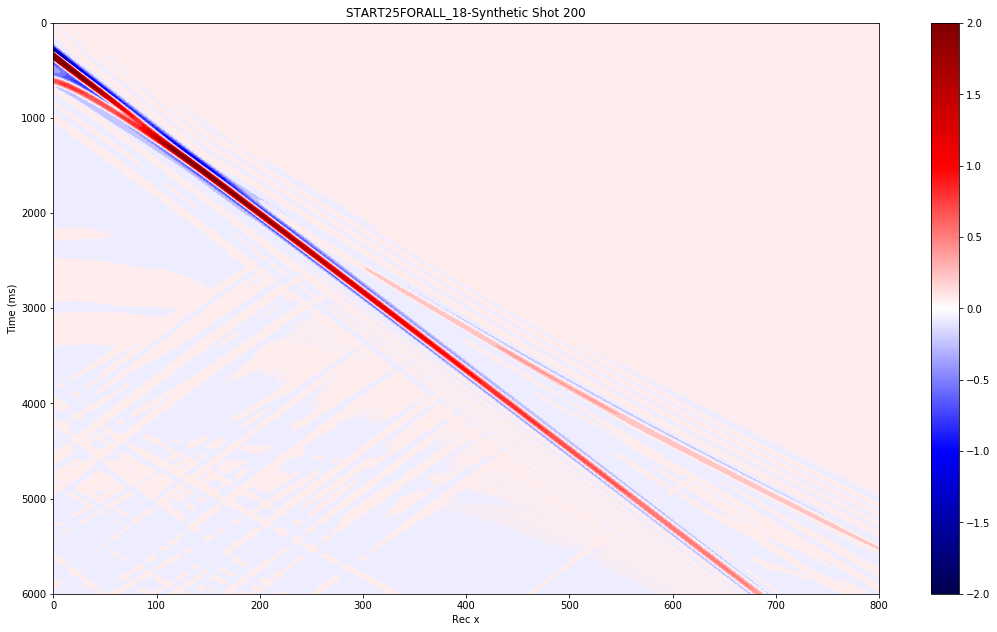

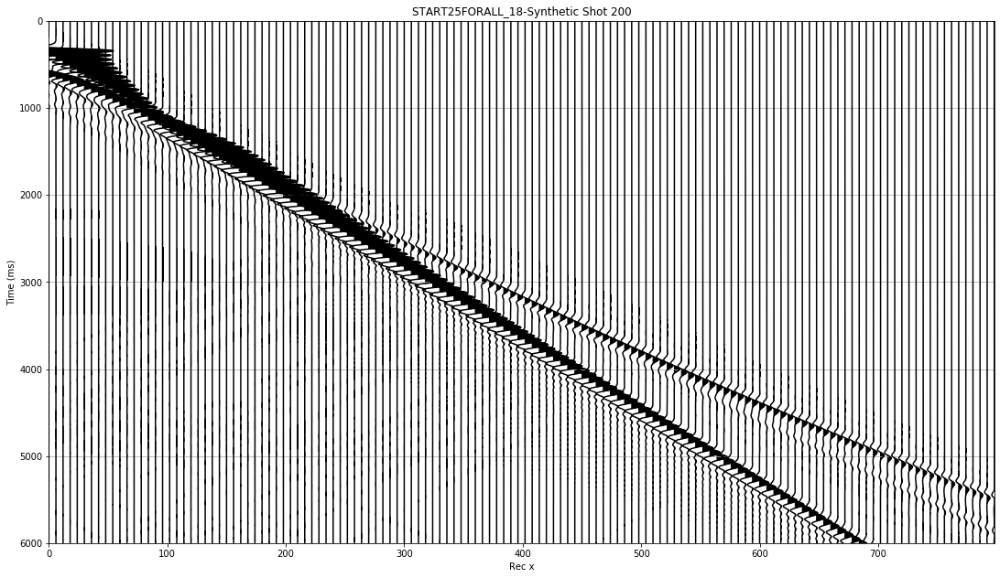

In [16]:
visual.amplitude(START_DATA_NORM, shot=shot_no, vmin=-2, vmax=2)
visual.wiggle(START_DATA_NORM, shot=shot_no, scale=14.5, skip_trace=5)

2019-08-22 13:47:47.852478 	 Sampling Frequency = 500.0000 Hz

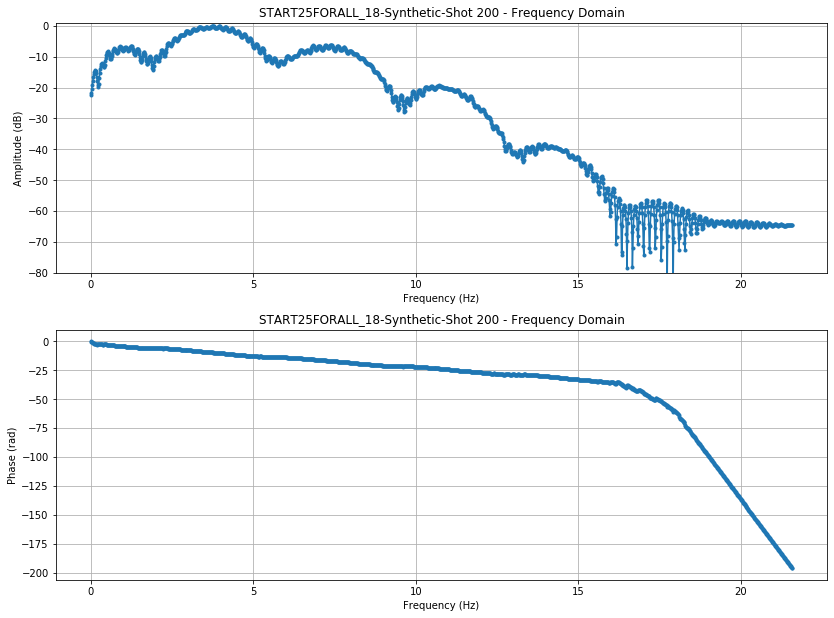

In [17]:
# Looking at the frequency content of the predicted data and ensuring it is within expectations
start_spec = siganalysis.dataspec(START_DATA_NORM, shot=shot_no, ms=True, fmax=18, plot=True, fft_smooth=10)

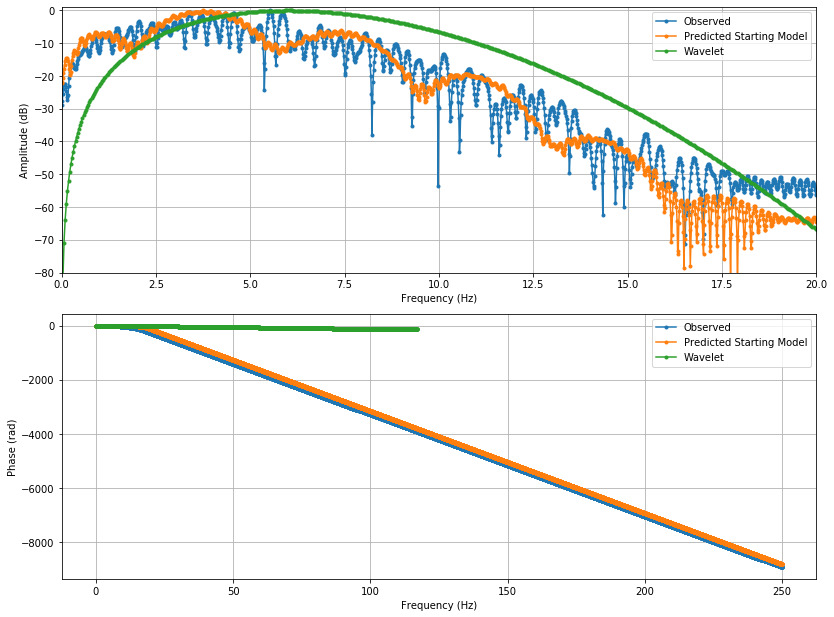

In [18]:
# Frequency density comparison between observed and predicted data
figure, ax = plt.subplots(2, 1)
figure.set_size_inches(11.5, 8.5)

ax[0].plot(obs_spec[0], obs_spec[1], '.-', label="Observed")
ax[0].plot(start_spec[0], start_spec[1], '.-', label="Predicted Starting Model")
ax[0].plot(wavelet[0], wavelet[1], '.-', label="Wavelet")

ax[0].grid()
ax[0].set(xlabel="Frequency (Hz)",
          ylabel="Amplitude (dB)")
ax[0].set_ylim(-80, 1)
ax[0].set_xlim(0, 20)

ax[1].plot(obs_spec[0], obs_spec[2], '.-', label="Observed")
ax[1].plot(start_spec[0], start_spec[2], '.-', label="Predicted Starting Model")
ax[1].plot(wavelet[0], wavelet[2], '.-', label="Wavelet")
ax[1].set(xlabel="Frequency (Hz)",
          ylabel="Phase (rad)")
ax[1].grid()
ax[1].legend(loc="best")
ax[0].legend(loc="best")
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)

# Visual Comparison of Starting Model Synthetics with Observed Data (Early Arrivals)

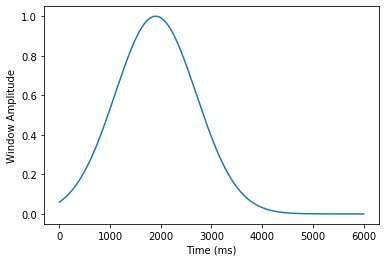

In [19]:
# Early arrivals window. This is the gaussian window applied to perform the xcorr and phase-diff signal analysis
xstart, xend = 0, 400
wstart, wend = 300, 3500

w = siganalysis.gausswindow(samples=OBS_BASE_DATA.samples[0], wstart=wstart, wend=wend, dt=OBS_BASE_DATA.dt[0])
t = np.arange(0, OBS_BASE_DATA.samples[0], 1)*OBS_BASE_DATA.dt[0]
plt.xlabel("Time (ms)")
plt.ylabel("Window Amplitude")
plt.plot(t, w)
plt.show()

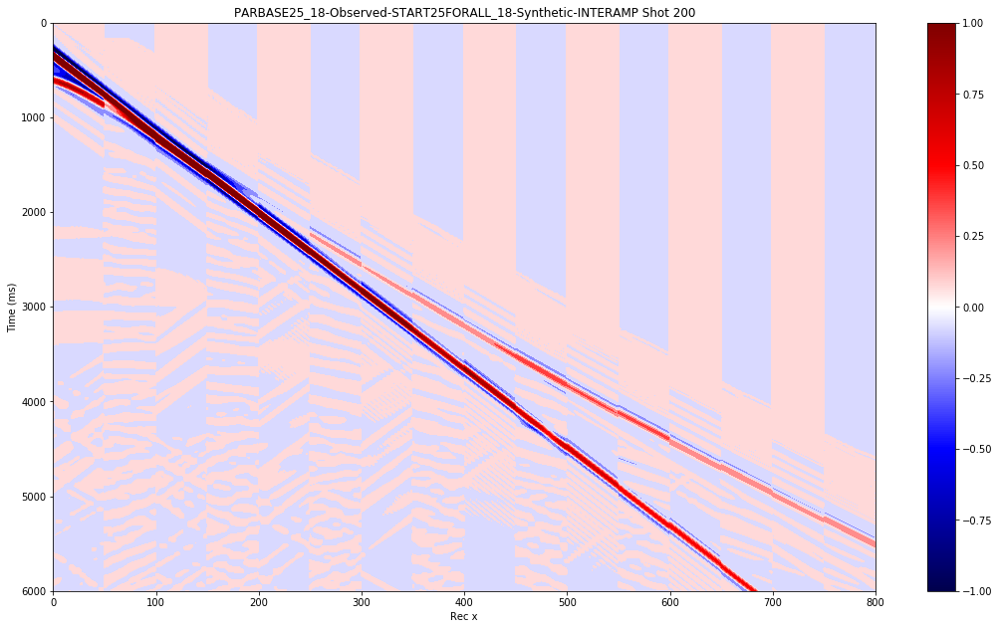

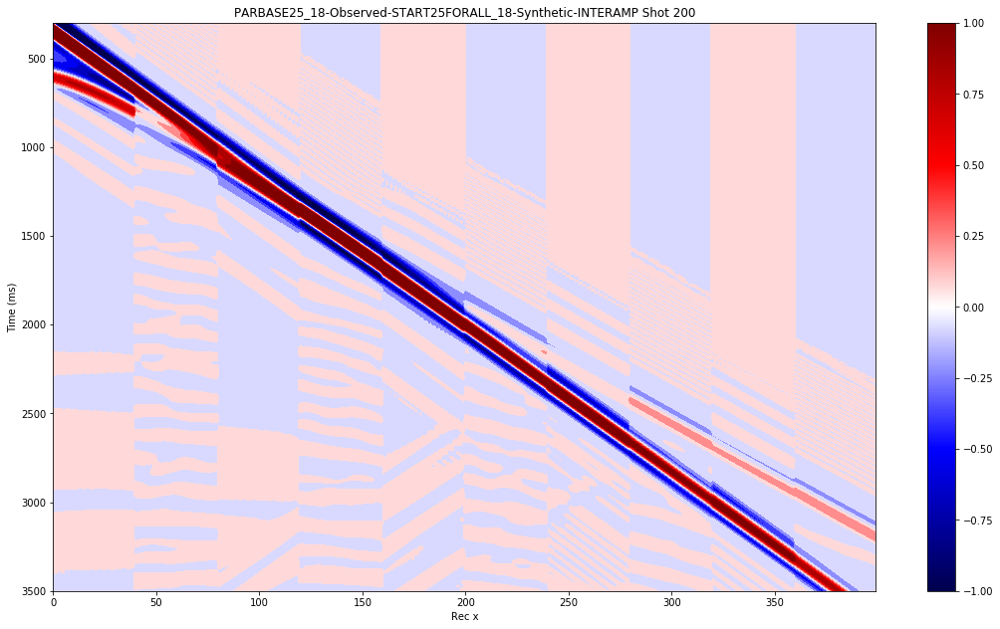

In [20]:
# Interleaving shots for comparison between starting model and observed dataset. Check for cycle skipping.
visual.interamp(START_DATA_NORM, OBS_BASE_DATA, n_blocks=16, shot=shot_no, vmin=-1, vmax=1)
visual.interamp(START_DATA_NORM, OBS_BASE_DATA, n_blocks=20, shot=shot_no, vmin=-1, vmax=1, \
                xstart=xstart, xend=xend, wstart=wstart, wend=wend)   # early arrivals

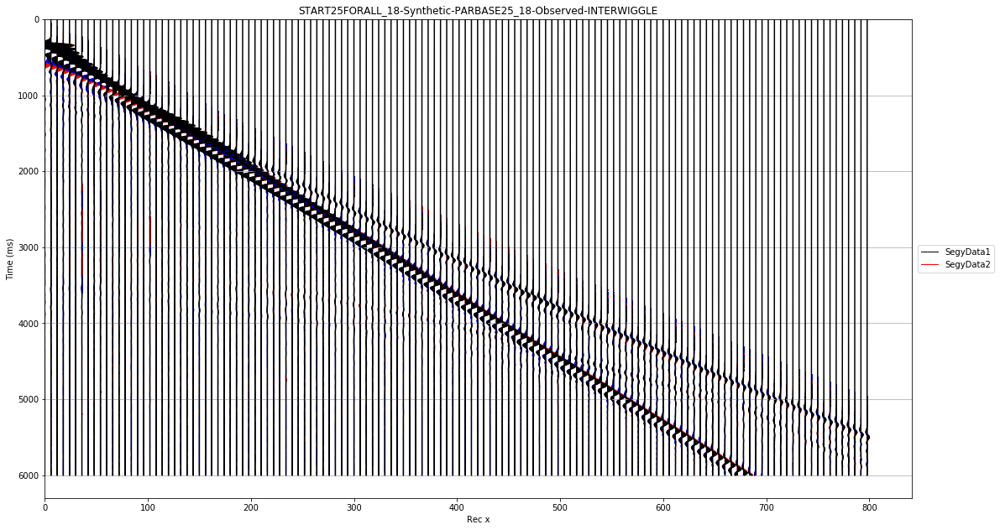

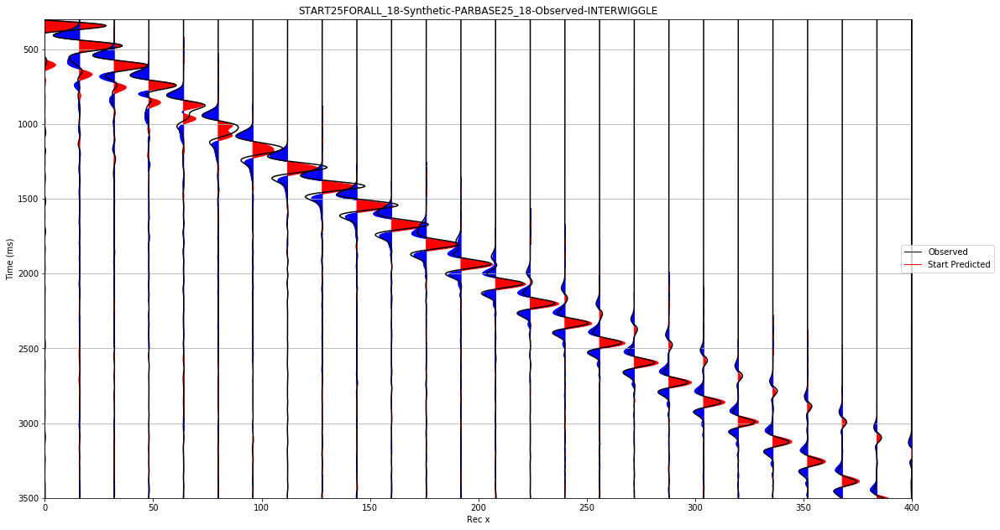

In [21]:
visual.interwiggle(OBS_BASE_DATA, START_DATA_NORM , overlay=1, scale=7.5, skip_trace=5, shot=shot_no)
visual.interwiggle(OBS_BASE_DATA, START_DATA_NORM , overlay=2, scale=7.5, skip_trace=15, shot=shot_no, \
                   xstart=xstart, xend=xend, wstart=wstart, wend=wend, label1="Observed", label2="Start Predicted")

# Signal Analysis of Starting Model Synthetics (Early Arrivals)

2019-08-22 13:53:39.198259                   	 All phases calculated successfully 


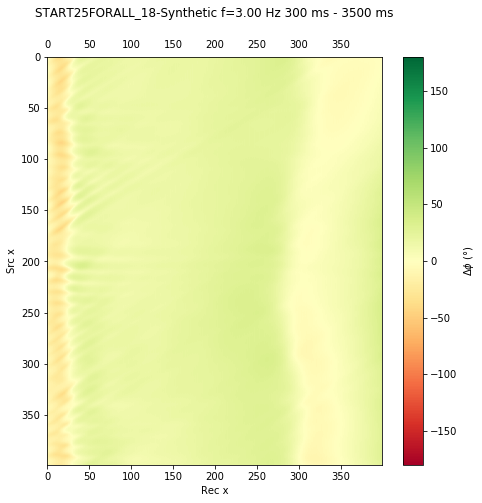

In [22]:
# Computing phase differences at lowest usable frequency (correspondent to the 3Hz frequency block from the 
# frequency continuation scheme set in 'examples/Runfiles/PARBASE25_18-Runfile.key')
pd_start3 = siganalysis.phasediff(START_DATA, OBS_BASE_DATA, f=3, wstart=wstart, wend=wend, nr_max=xend, ns_max=400, fft_smooth=3, plot=True)

# The inverted model (PARBASE25_18)


2019-08-22 13:53:43.270664 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-CP00130-Vp.sgy...
2019-08-22 13:53:43.274446 	 Reading model...
2019-08-22 13:53:43.281991 	 Successfully loaded model of size 201 x 661!

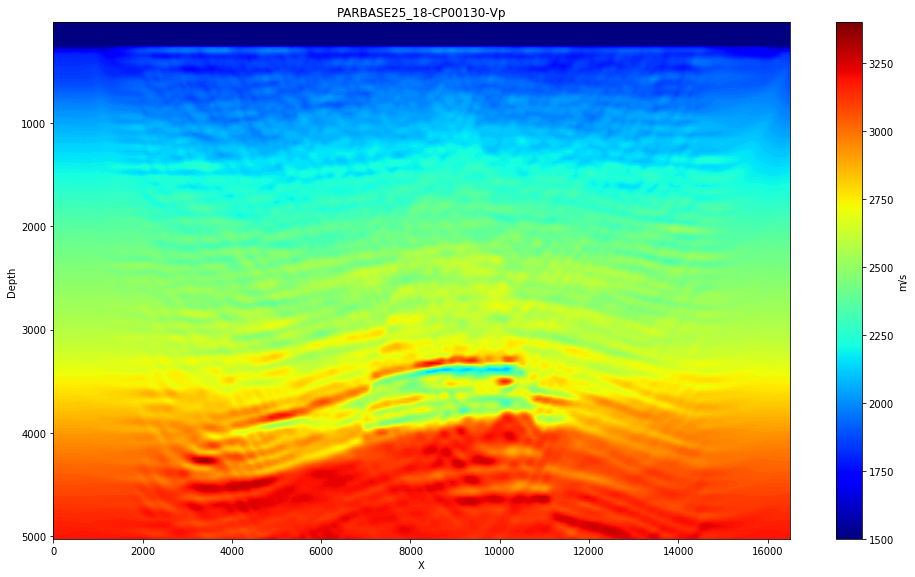

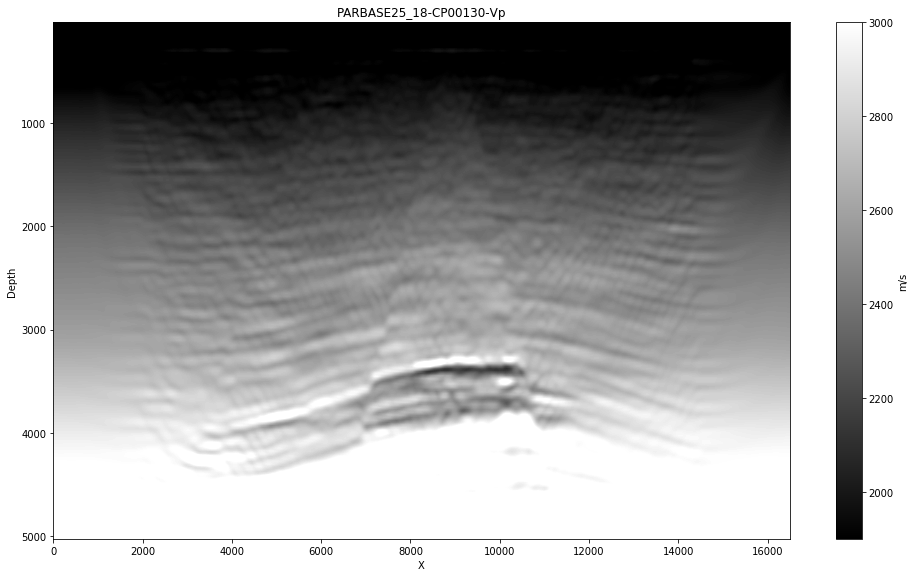

In [23]:
it=130
model_path = path + "PARBASE25_18-CP" + format(it, "05") + "-Vp.sgy"
CP18 = tools.load(model_path, model=True, verbose=1)
visual.vpmodel(CP18, vmin=1500, vmax=3400)
visual.vpmodel(CP18, vmin=1900, vmax=3000, cmap="gray")

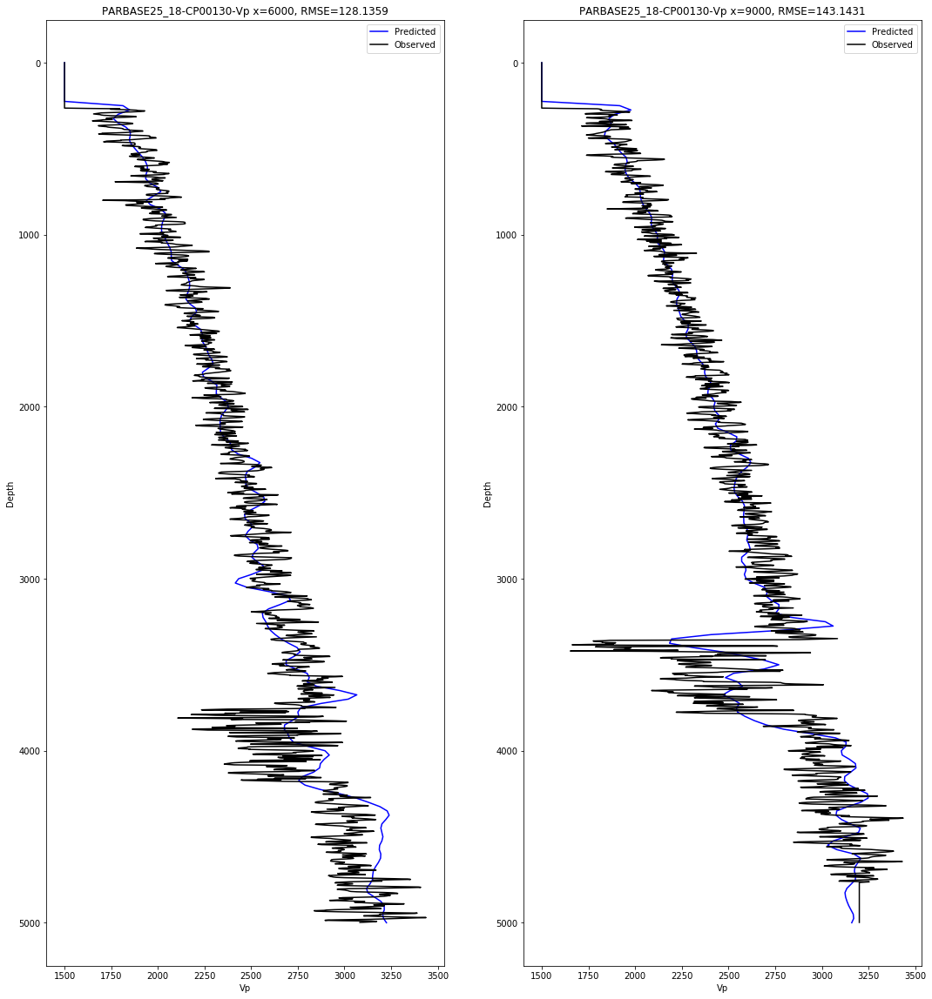

In [24]:
# Plot Vp logs of predicted and true models
wells_cp = visual.vpwell(CP18, pos_x=x_list, TrueModel=TRUE_BASE, plot=True)

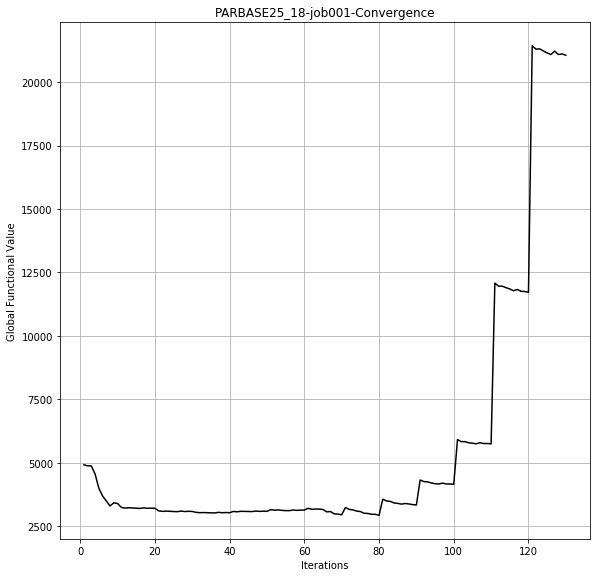

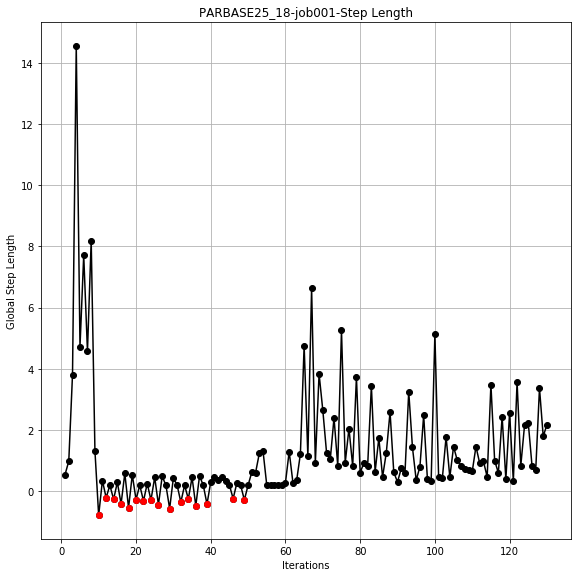

In [25]:
# Retrieving functional and step length information from job log
job_path = path + "PARBASE25_18-job001.log"
b = inversion.functional(job_path, plot=True)
_ = inversion.steplen(job_path, plot=True)

In [26]:
visual.animateinv(it_max=130, path=path, project_name="PARBASE25_18", vmin=1500, vmax=3400, verbose=1)

2019-08-22 13:53:51.054096 	 Loading model 130 ...
2019-08-22 13:53:51.054138 	 Creating animation...

# Forward Run on Inverted Model Iteration 130 (PARBASE25FORALL_18)
After performing a synthetic run over the final model of PARBASE25_18 with same modelling parameters

In [27]:
PRD_BASE_DATA = tools.load("/geophysics2/dpelacani/PROJECTS/PARBASE25FORALL_18/PARBASE25FORALL_18-Synthetic.sgy", model=False, verbose=1)


2019-08-22 13:54:09.874738 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25FORALL_18/PARBASE25FORALL_18-Synthetic.sgy...
2019-08-22 13:54:09.883945 	 Loading data...
2019-08-22 13:55:02.456753 	 521 shots found. Loading headers...
2019-08-22 13:56:15.590374 	 322149 total traces read
2019-08-22 13:56:15.590713 	 Data loaded successfully

In [28]:
# Normalise amplitude of predicted model synthetics for visualisation
PRD_BASE_NORM = tools.ampnorm(OBS_BASE_DATA, PRD_BASE_DATA, ref_trace=0, verbose=1)

2019-08-22 13:56:19.543156 	 All shots normalised

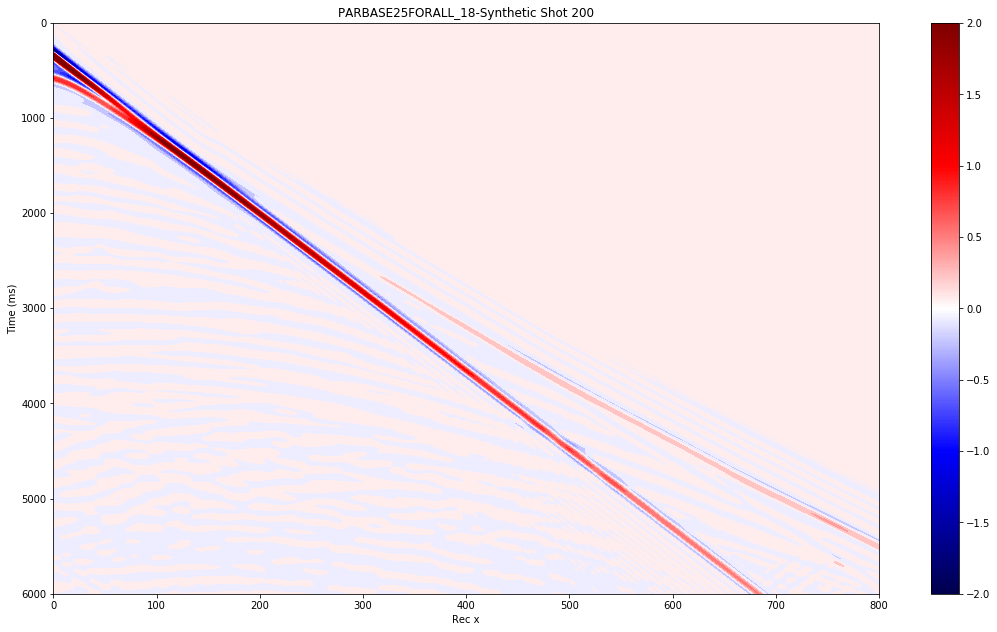

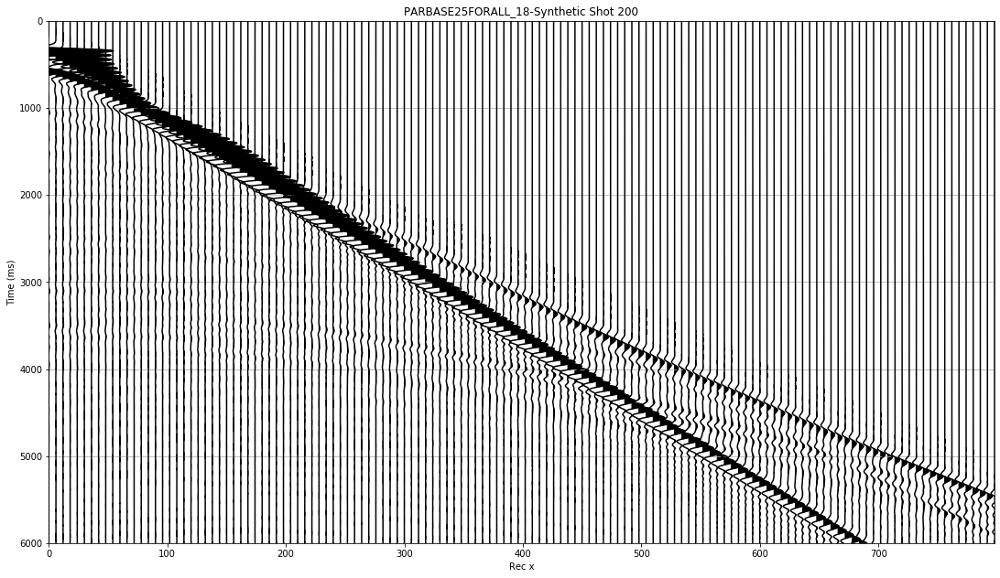

In [29]:
visual.amplitude(PRD_BASE_NORM, shot=shot_no, vmin=-2, vmax=2)
visual.wiggle(PRD_BASE_NORM, shot=shot_no, scale=14.5, skip_trace=5)

2019-08-22 13:56:25.240805 	 Sampling Frequency = 500.0000 Hz

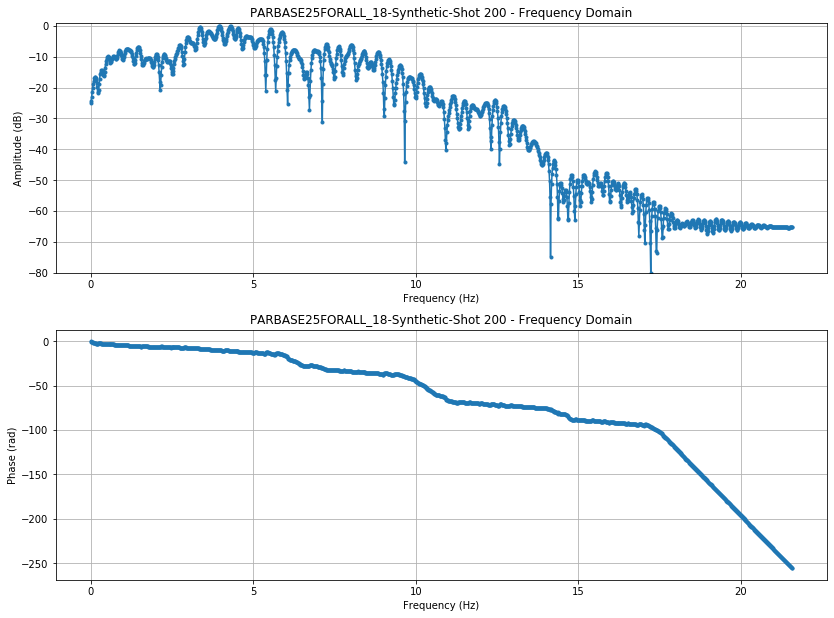

In [30]:
pred_spec = siganalysis.dataspec(PRD_BASE_NORM, shot=shot_no, ms=True, fmax=18, plot=True, fft_smooth=10)

# Visual Comparison of Predicted Model Synthetics with Observed Data (EARLY ARRIVALS)

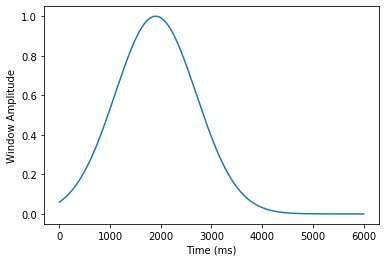

In [31]:
xstart, xend = 0, 400
wstart, wend = 300, 3500

w = siganalysis.gausswindow(samples=OBS_BASE_DATA.samples[0], wstart=wstart, wend=wend, dt=OBS_BASE_DATA.dt[0])
t1 = np.arange(0, OBS_BASE_DATA.samples[0], 1)*OBS_BASE_DATA.dt[0]
plt.xlabel("Time (ms)")
plt.ylabel("Window Amplitude")
plt.plot(t1, w)
plt.show()


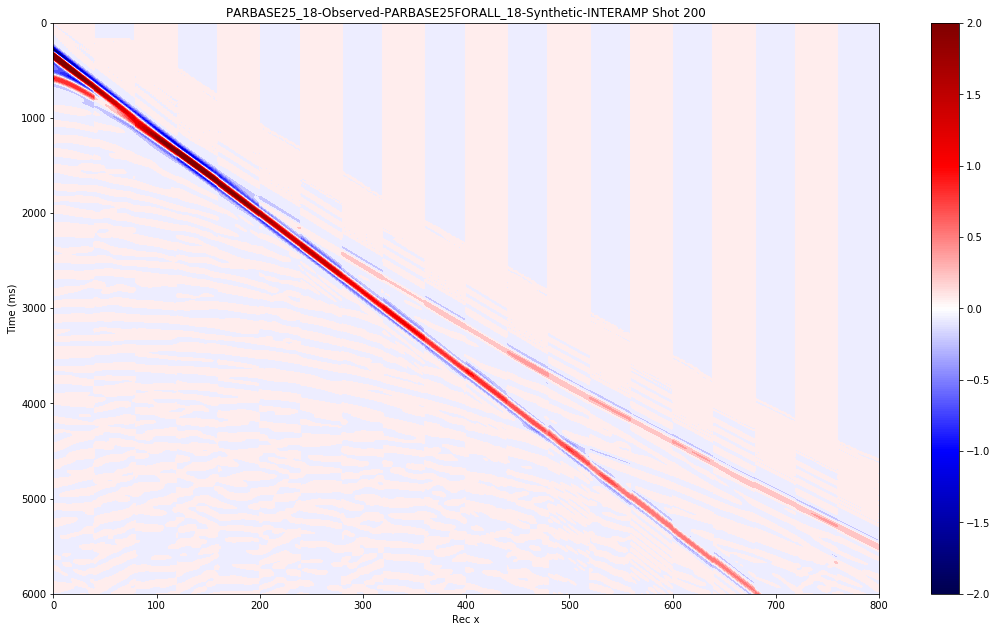

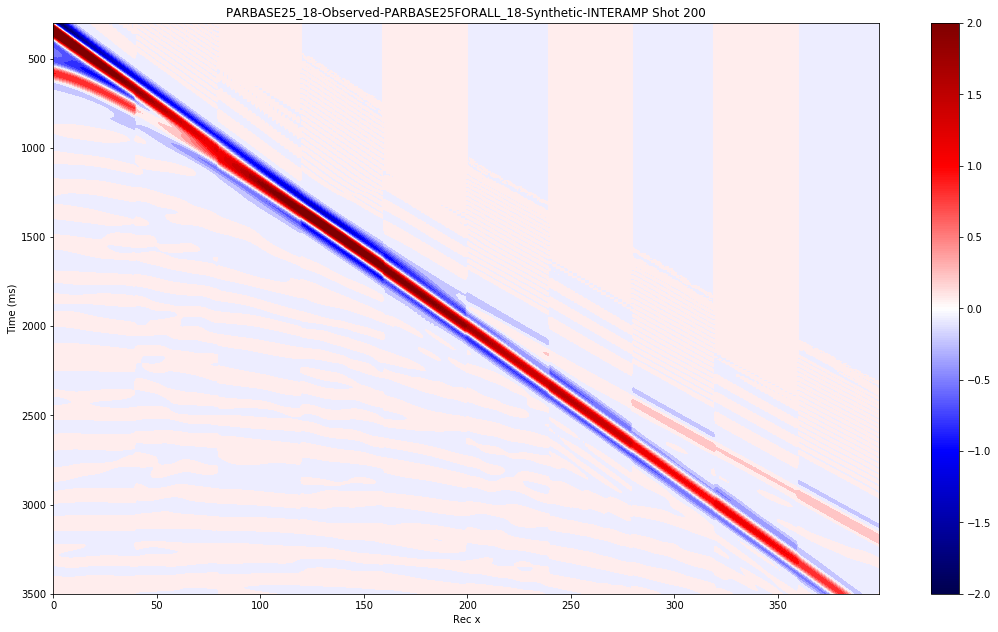

In [32]:
visual.interamp(PRD_BASE_NORM, OBS_BASE_DATA, n_blocks=20, shot=shot_no, vmin=-2, vmax=2)
visual.interamp(PRD_BASE_NORM, OBS_BASE_DATA, n_blocks=20, shot=shot_no, vmin=-2, vmax=2, \
                xstart=xstart, xend=xend, wstart=wstart, wend=wend)   # early arrivals

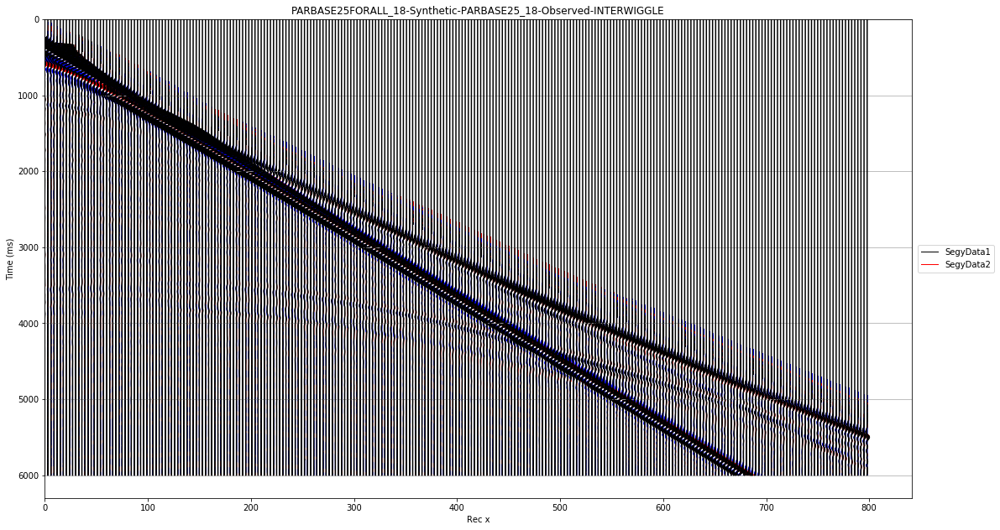

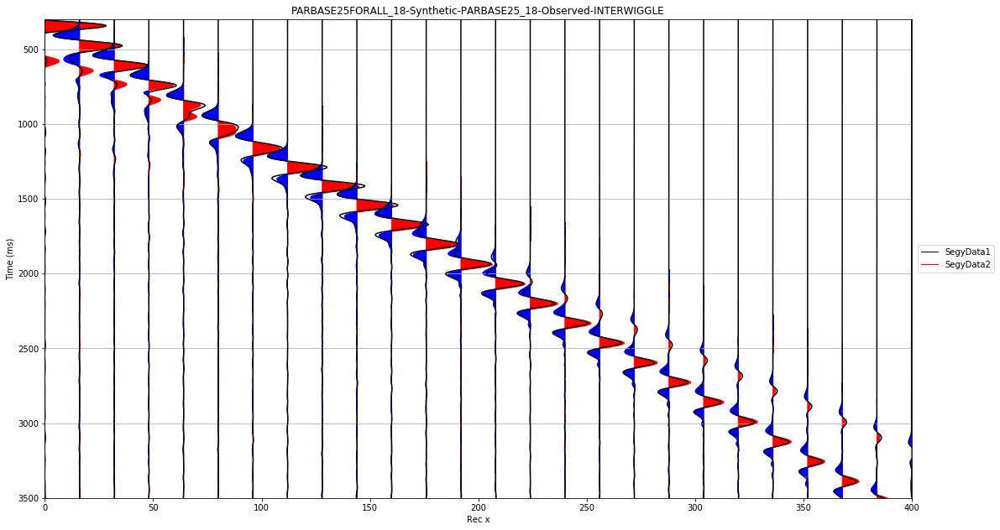

In [33]:
visual.interwiggle(OBS_BASE_DATA, PRD_BASE_NORM , overlay=1, scale=7.5, skip_trace=2, shot=shot_no)
visual.interwiggle(OBS_BASE_DATA, PRD_BASE_NORM , overlay=2, scale=7.5, skip_trace=15, shot=shot_no, \
                   xstart=xstart, xend=xend, wstart=wstart, wend=wend)

# Signal Analysis of Inverted Model Synthetics (EARLY ARRIVALS)

2019-08-22 14:02:56.938573                   	 All phases calculated successfully 


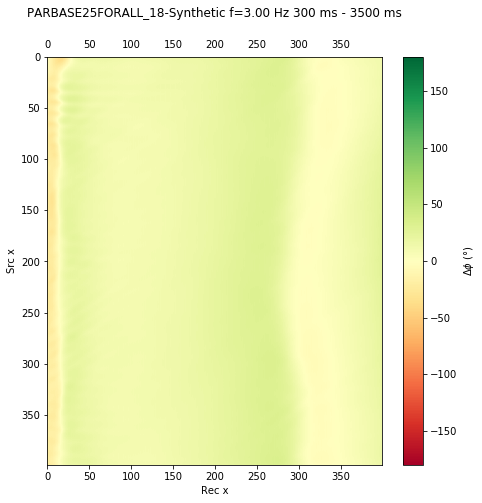

In [34]:
pd_pred3 = siganalysis.phasediff(PRD_BASE_NORM, OBS_BASE_DATA, f=3, wstart=wstart, wend=wend, nr_min=xstart, nr_max=xend, ns_max=400, fft_smooth=3, plot=True)

2019-08-22 14:03:14.306528                   	 All cross-correlations calculated successfully 


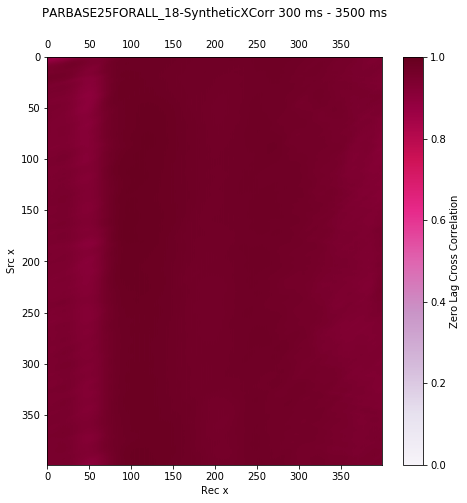

2019-08-22 14:03:34.398741                   	 All cross-correlations calculated successfully 


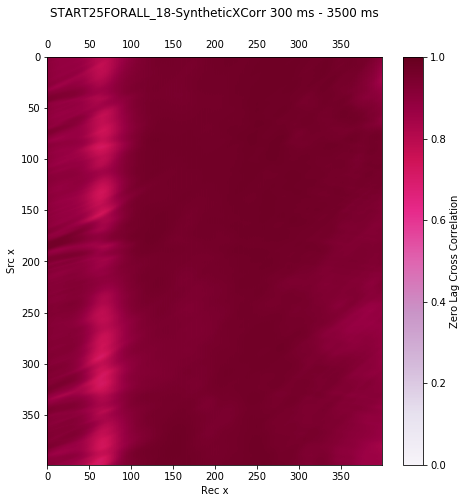

In [35]:
# Compute cross correlation for starting and predicted model and guaranteed that it has improved -- early arrivals
xc_pred = siganalysis.xcorr(PRD_BASE_DATA, OBS_BASE_DATA, wstart=wstart, wend=wend, nr_max=xend, ns_max=400, plot=True)
xc_start = siganalysis.xcorr(START_DATA_NORM, OBS_BASE_DATA, wstart=wstart, wend=wend, nr_max=xend, ns_max=400, plot=True)

# Visual Comparison of Predicted Model Synthetics with Observed Data (RESERVOIR DEPTH)

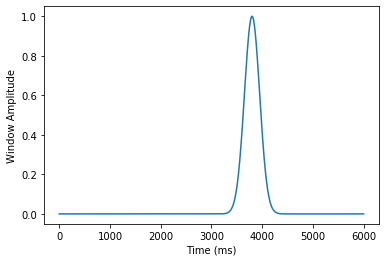

In [36]:
# Reservoir depth window
xstart1, xend1 = 100, 300
wstart1, wend1 = 3500, 4100

w1 = siganalysis.gausswindow(samples=OBS_BASE_DATA.samples[0], wstart=wstart1, wend=wend1, dt=OBS_BASE_DATA.dt[0])
t1 = np.arange(0, OBS_BASE_DATA.samples[0], 1)*OBS_BASE_DATA.dt[0]
plt.xlabel("Time (ms)")
plt.ylabel("Window Amplitude")
plt.plot(t1, w1)
plt.show()


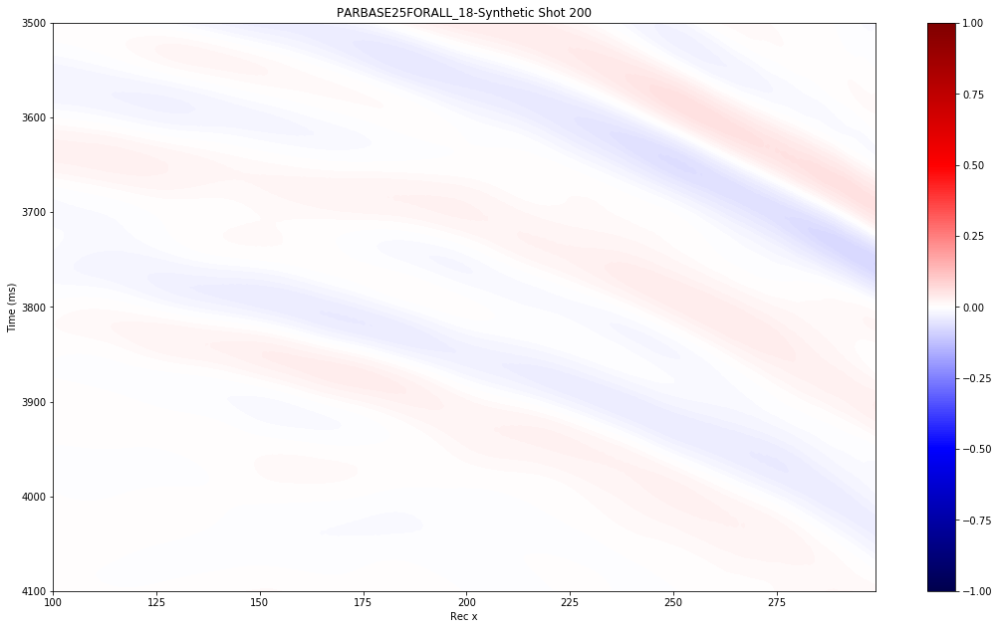

In [37]:
visual.amplitude(PRD_BASE_NORM, shot=shot_no, vmin=-1, vmax=1, \
                xstart=xstart1, xend=xend1, wstart=wstart1, wend=wend1) # reservoir depth

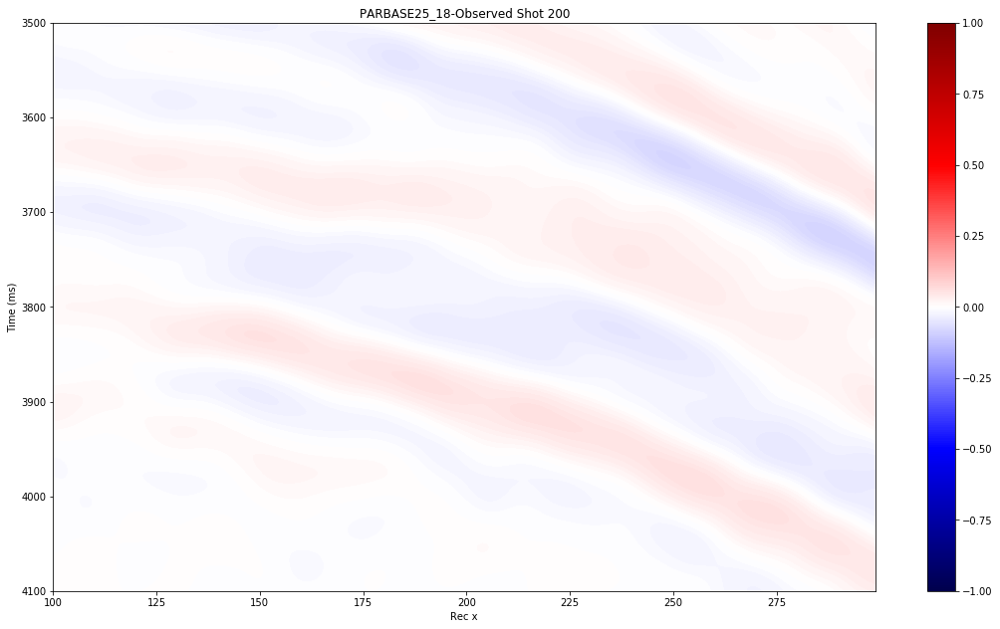

In [38]:
visual.amplitude(OBS_BASE_DATA, shot=shot_no, vmin=-1, vmax=1, \
                xstart=xstart1, xend=xend1, wstart=wstart1, wend=wend1) # reservoir depth

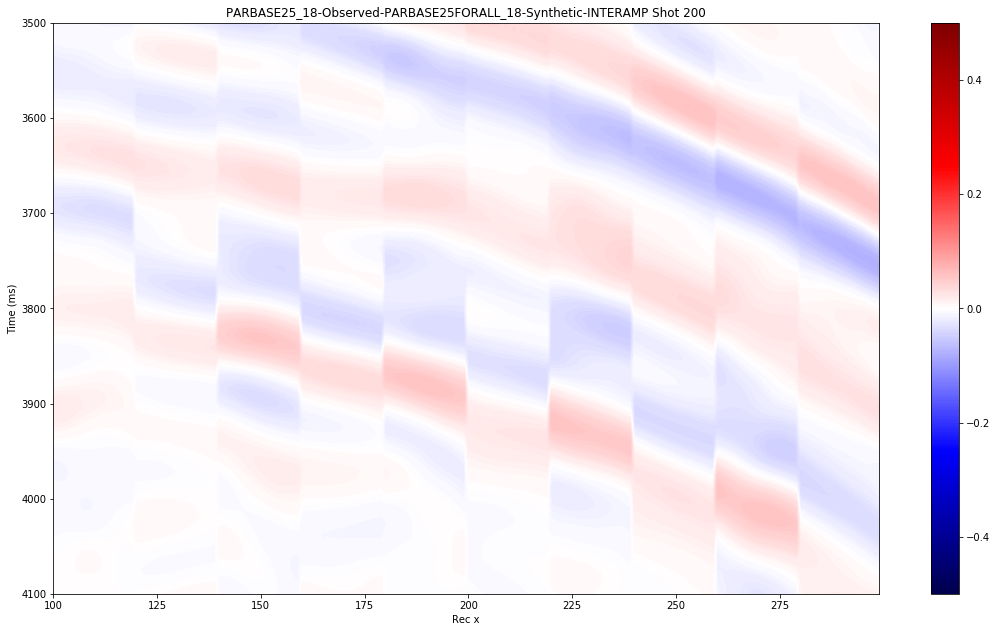

In [39]:
visual.interamp(PRD_BASE_NORM, OBS_BASE_DATA, n_blocks=40, shot=shot_no, vmin=-0.5, vmax=0.5, \
                xstart=xstart1, xend=xend1, wstart=wstart1, wend=wend1) # reservoir depth

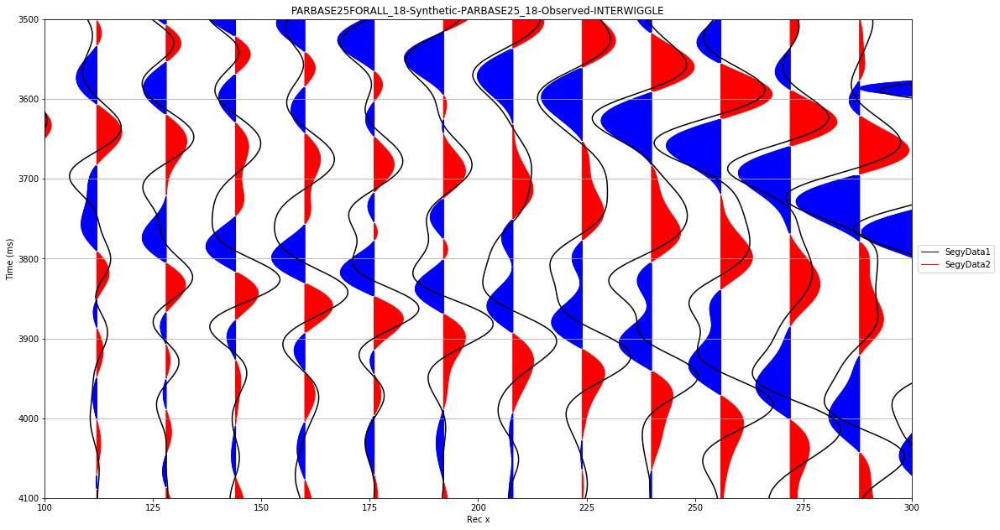

In [40]:
# visual.interwiggle(OBS_BASE_DATA, PRD_BASE_NORM , overlay=1, scale=7.5, skip_trace=2, shot=shot_no)
visual.interwiggle(OBS_BASE_DATA, PRD_BASE_NORM , overlay=2, scale=200, skip_trace=15, shot=shot_no, \
                   xstart=xstart1, xend=xend1, wstart=wstart1, wend=wend1)

# Signal Analysis of Inverted Model Synthetics (RESERVOIR DEPTH)

2019-08-22 14:03:49.935261                   	 All cross-correlations calculated successfully 


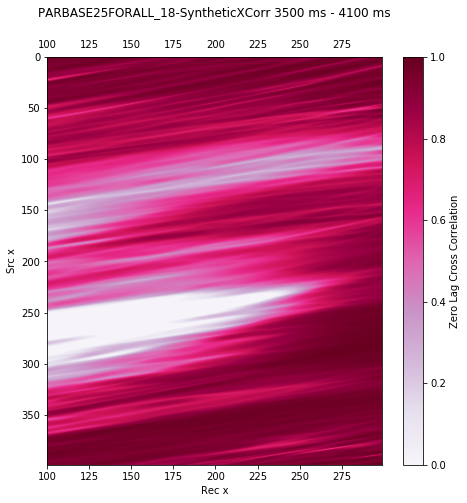

2019-08-22 14:03:59.562460                   	 All cross-correlations calculated successfully 


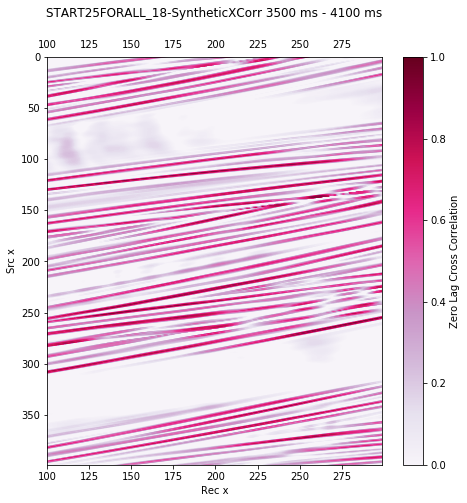

In [41]:
# Compute cross correlation for starting and predicted model and guaranteed that it has improved -- reservoir depth
xc_start_res = siganalysis.xcorr(PRD_BASE_DATA, OBS_BASE_DATA, wstart=wstart1, nr_min=xstart1, wend=wend1, nr_max=xend1, ns_max=400, plot=True)
xc_pred_res = siganalysis.xcorr(START_DATA_NORM, OBS_BASE_DATA, wstart=wstart1, nr_min=xstart1,  wend=wend1, nr_max=xend1, ns_max=400, plot=True)

# Full window cross-correlation comparison beteween starting and final models

2019-08-22 14:04:38.496545                   	 All cross-correlations calculated successfully 


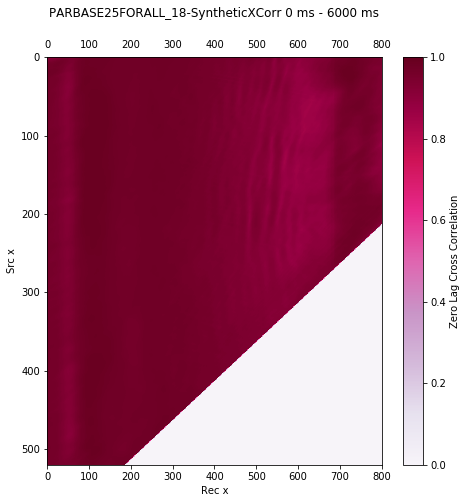

2019-08-22 14:05:15.950139                   	 All cross-correlations calculated successfully 


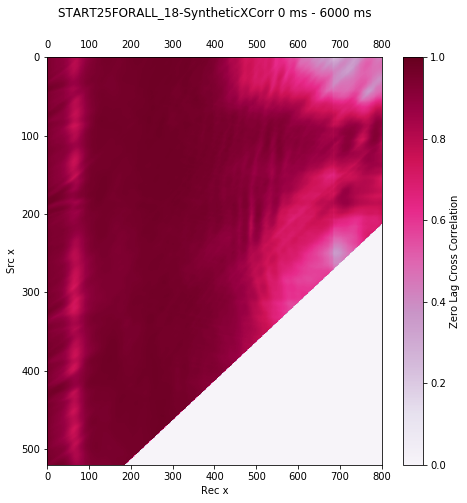

In [42]:
# Compute cross correlation for starting and predicted model and guaranteed that it has improved -- full window
xc_pred_full = siganalysis.xcorr(PRD_BASE_DATA, OBS_BASE_DATA, wstart=0, wend=6000, nr_min=0, nr_max=801, ns_max=521, plot=True)
xc_start_full = siganalysis.xcorr(START_DATA_NORM, OBS_BASE_DATA, wstart=0, wend=6000, nr_min=0, nr_max=801, ns_max=521, plot=True)

# PARMON25_18 (Iteration 130)
Use same inversion parameters of PARBASE25_18 to produce a model to the monitor dataset


2019-08-22 14:05:22.118122 	 Opening file /geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-CP00130-Vp.sgy...
2019-08-22 14:05:22.122055 	 Reading model...
2019-08-22 14:05:22.131907 	 Successfully loaded model of size 201 x 661!

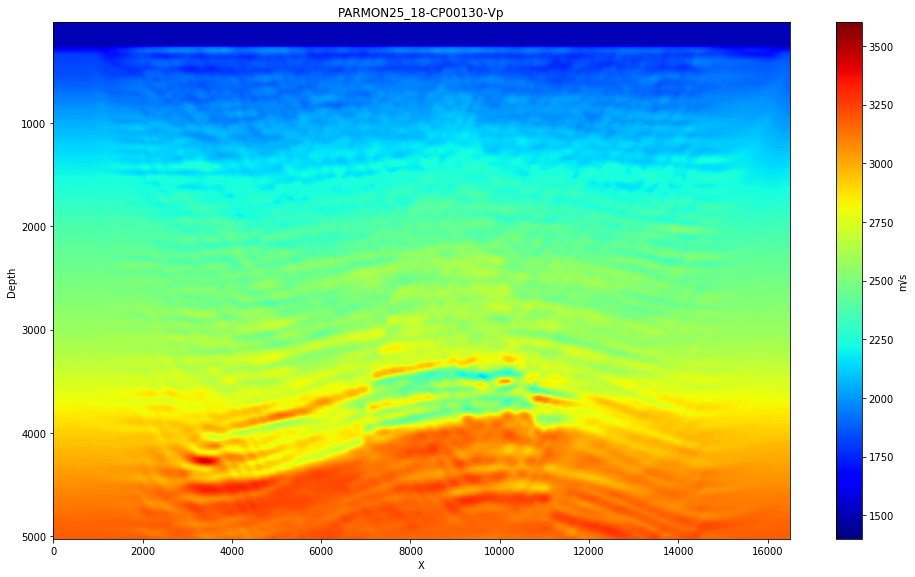

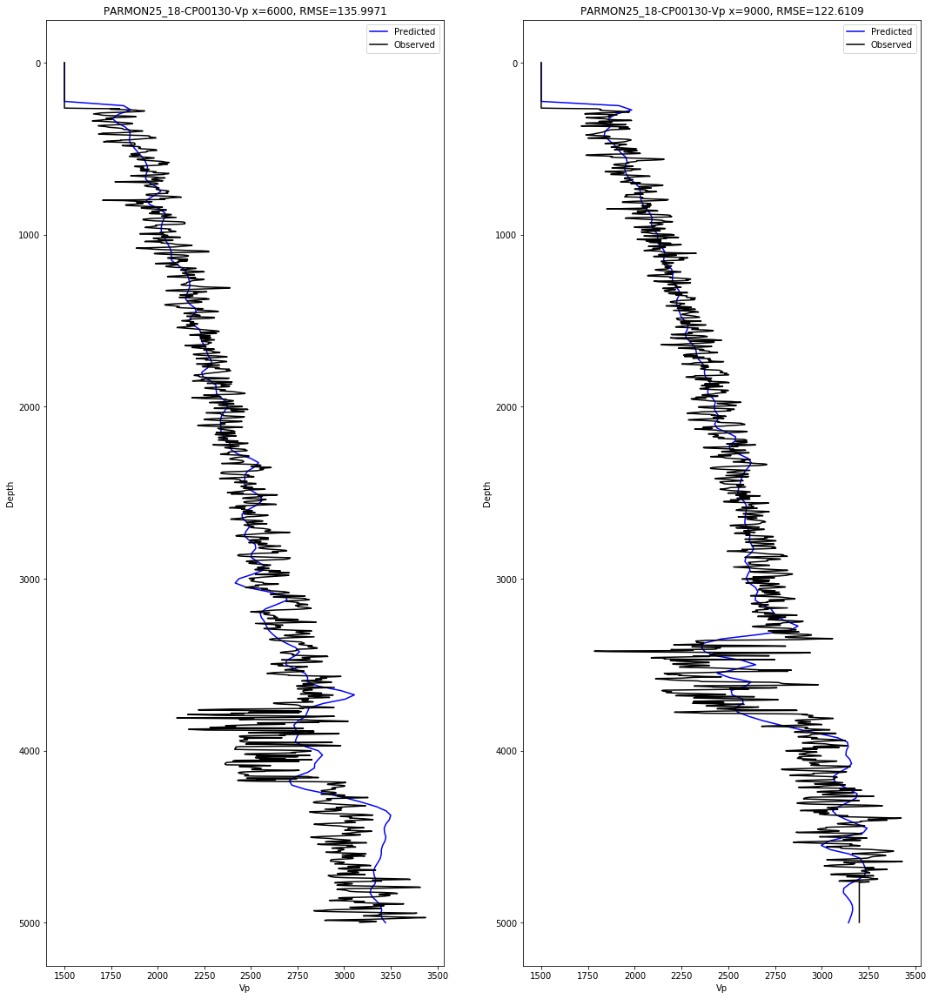

In [43]:
mon_path = "/geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-CP" + format(130, "05") + "-Vp.sgy"
CPMON18 = tools.load(mon_path, model=True, verbose=1)
visual.vpmodel(CPMON18, vmin=1400, vmax=3600)
_ = visual.vpwell(Model=CPMON18, pos_x=x_list, TrueModel=TRUE_MON, plot=True)

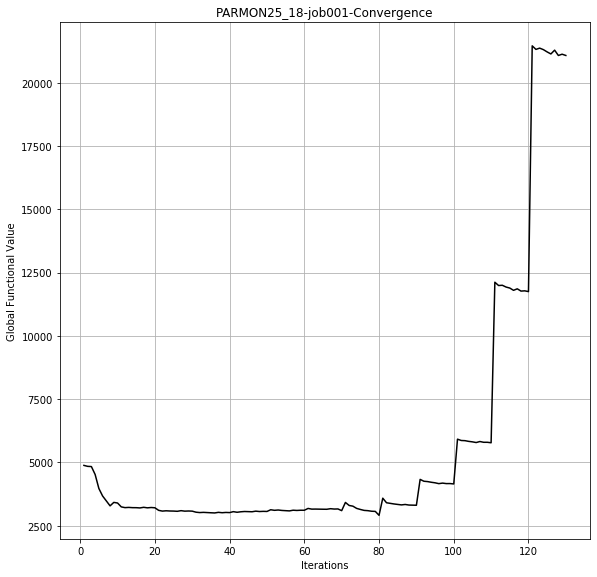

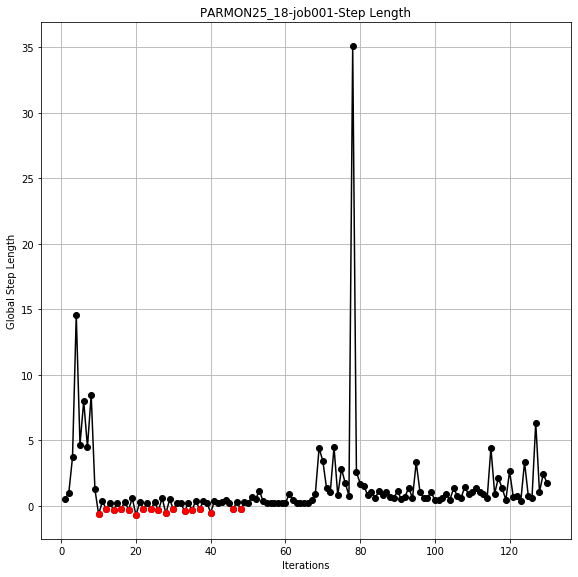

In [44]:
job_path = "/geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-job001.log"
m = inversion.functional(job_path, plot=True)
_ = inversion.steplen(job_path, plot=True)

In [45]:
visual.animateinv(it_max=130, path="/geophysics2/dpelacani/PROJECTS/PARMON25_18/", project_name="PARMON25_18", vmin=1500, vmax=3400, verbose=1)

2019-08-22 14:05:28.034943 	 Loading model 130 ...
2019-08-22 14:05:28.034989 	 Creating animation...

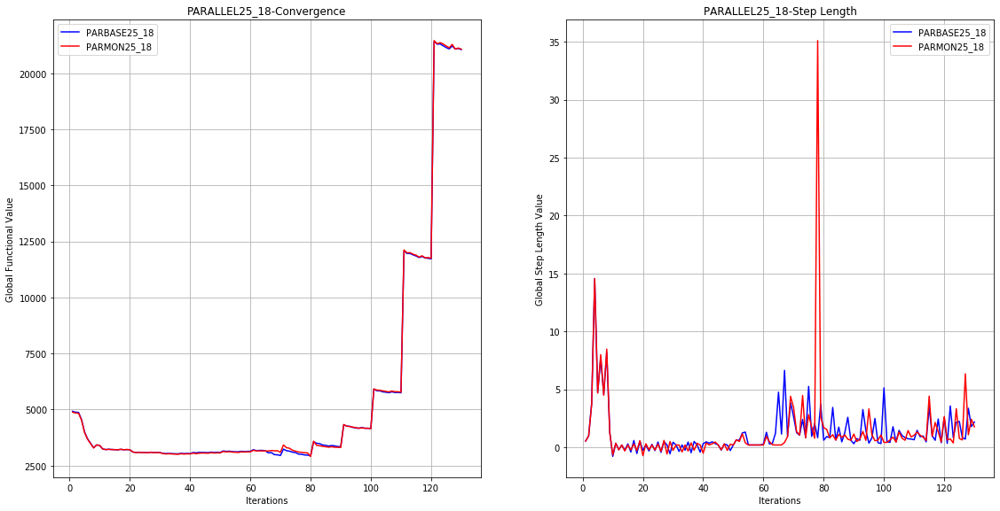

In [46]:
# Comparing the functional evolution of PARBASE25_18 and PARMON25_18 to guarantee that timelapse 
# difference will be stable
PARBASEFUNC18=inversion.functional("/geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-job001.log")
PARMONFUNC18=inversion.functional("/geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-job001.log")
PARBASESTEP18=inversion.steplen("/geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-job001.log")
PARMONSTEP18=inversion.steplen("/geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-job001.log")
figure, ax = plt.subplots(1, 2)
figure.set_size_inches(19, 9.5)
ax[0].plot(PARBASEFUNC18[0], PARBASEFUNC18[1], 'b-', label="PARBASE25_18")
ax[0].plot(PARMONFUNC18[0], PARMONFUNC18[1], 'r-', label="PARMON25_18")
ax[0].set_xlabel("Iterations")
ax[0].set_ylabel("Global Functional Value")
ax[0].set_title("PARALLEL25_18" + "-Convergence")
ax[0].grid(True)
ax[0].legend(loc="best")
ax[1].plot(PARBASESTEP18[0], PARBASESTEP18[1], 'b-', label="PARBASE25_18")
ax[1].plot(PARMONSTEP18[0], PARMONSTEP18[1], 'r-', label="PARMON25_18")
ax[1].set_xlabel("Iterations")
ax[1].set_ylabel("Global Step Length Value")
ax[1].set_title("PARALLEL25_18" + "-Step Length")
ax[1].grid(True)
ax[1].legend(loc="best")
plt.show()

# Parallel Difference (PARDIFF25_18)

In [47]:
# The true difference
TRUE_DIFF = copy.deepcopy(TRUE_BASE)
TRUE_DIFF.name = "TRUE_DIFF"
TRUE_DIFF.data = TRUE_MON.data - TRUE_BASE.data

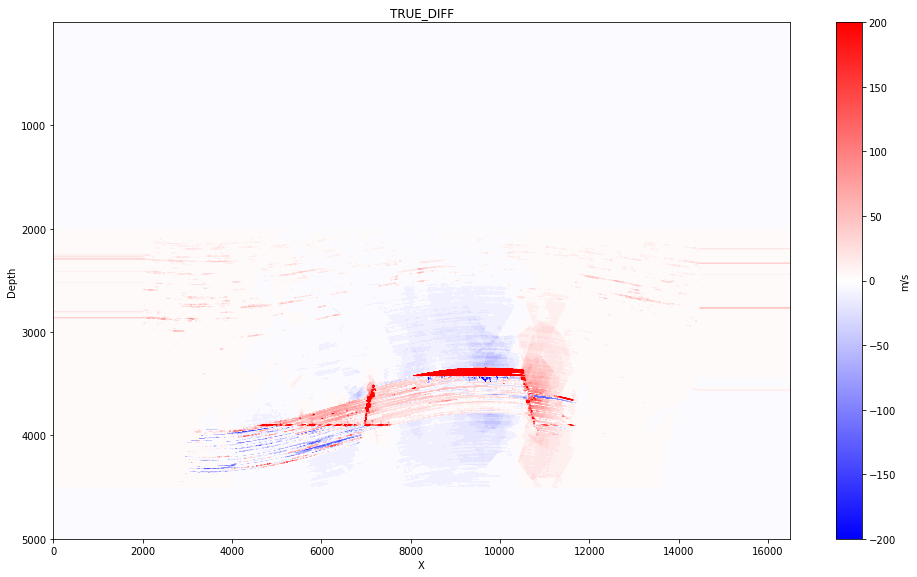

In [48]:
visual.vpmodel(TRUE_DIFF, cmap="bwr", vmin=-200, vmax=200)


2019-08-22 14:08:44.374177 	 Opening file /geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-CP00130-Vp.sgy...
2019-08-22 14:08:44.378357 	 Reading model...
2019-08-22 14:08:44.391726 	 Successfully loaded model of size 201 x 661!
2019-08-22 14:08:44.392879 	 Opening file /geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-CP00130-Vp.sgy...
2019-08-22 14:08:44.395948 	 Reading model...
2019-08-22 14:08:44.405199 	 Successfully loaded model of size 201 x 661!

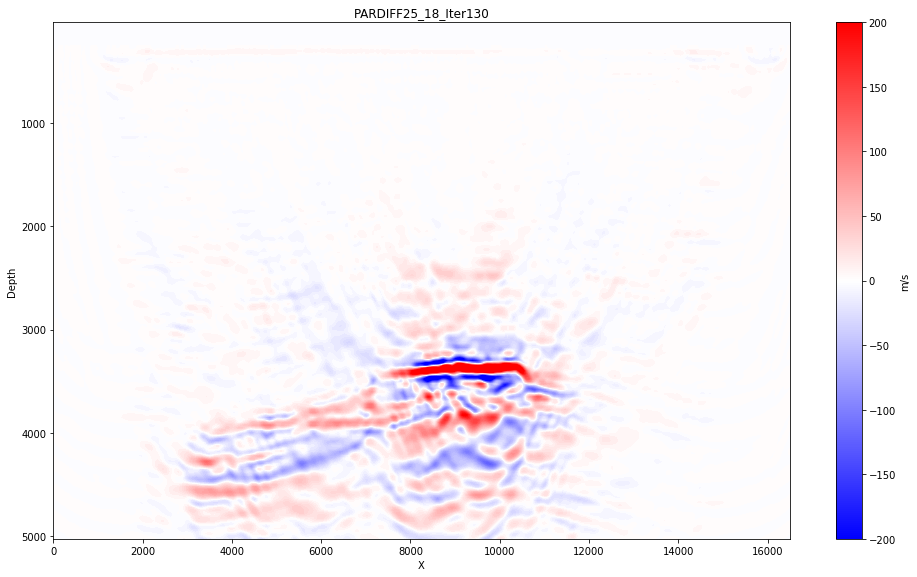

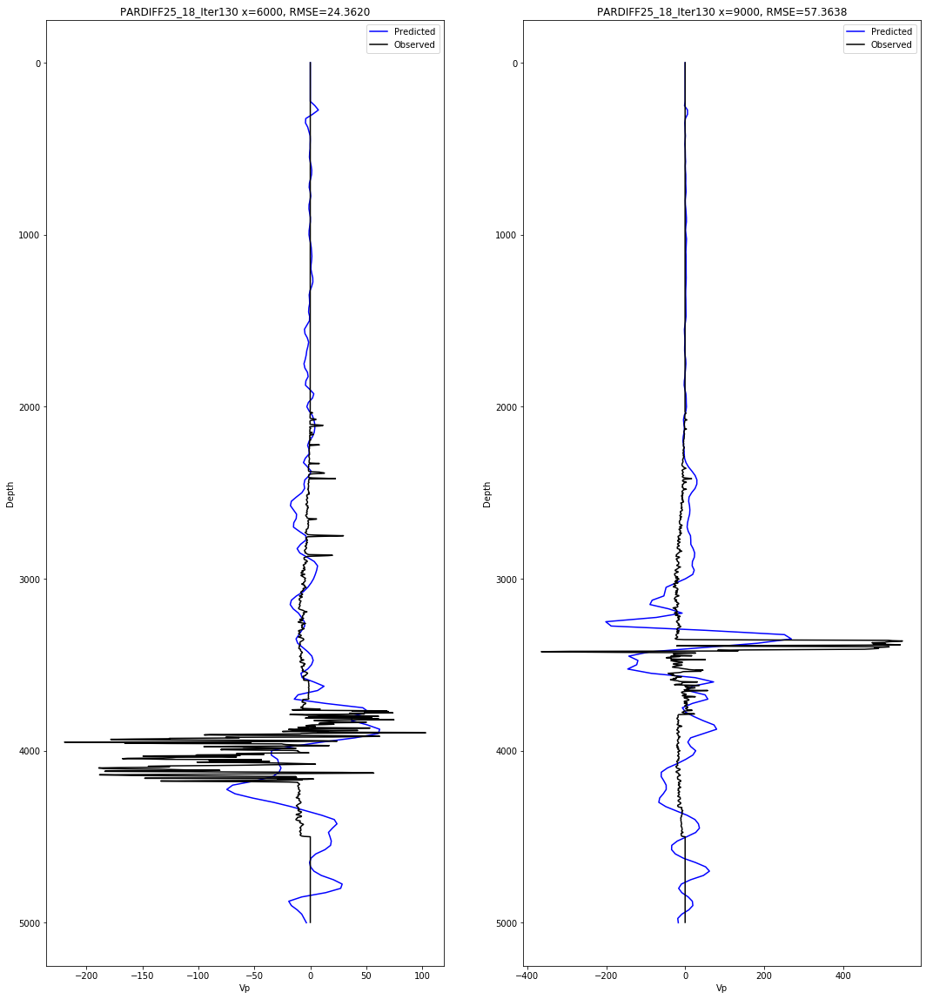

In [50]:
# Compute and plot PARMON25_18-CP00130 - PARBASE25_18-CP00130, visualise difference at well positions
it = 130
base_path = "/geophysics2/dpelacani/PROJECTS/PARBASE25_18/PARBASE25_18-CP" + format(it, "05") + "-Vp.sgy"
mon_path = "/geophysics2/dpelacani/PROJECTS/PARMON25_18/PARMON25_18-CP" + format(it, "05") + "-Vp.sgy"
CPBASE18 = tools.load(base_path, model=True, verbose=1)
CPMON18 = tools.load(mon_path, model=True, verbose=1)
CPDIFF18 = copy.deepcopy(CPBASE18)
CPDIFF18.name = "PARDIFF25_18_Iter%g" % it
CPDIFF18.data = CPMON18.data - CPBASE18.data

visual.vpmodel(CPDIFF18, cmap="bwr", vmin=-200, vmax=200)
_ = visual.vpwell(Model=CPDIFF18, pos_x=x_list , TrueModel=TRUE_DIFF, plot=True)
